<a href="https://colab.research.google.com/github/as14680/visiox/blob/master/SOT_as14680.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Name: Akshat Sharma

Net ID: as14680

Importing all the important libraries for creating the environment and the agent 

The system takes around 10-20 mins to run and execute so be patient. For formulaes I have taken reference from the link posted by prof. on slack for Kalman filter

In [5]:
!pip3 install tensorflow-gpu==1.14.0
!pip3 install numpy
!pip3 install tensorflow==2.2.0


!pip3 install scipy
!pip3 install opencv-python



!pip3 install pillow
!pip3 install matplotlib
!pip3 install h5py
!pip3 install keras==2.2.4



!pip3 install imageai --upgrade
import numpy as np

  Using cached tensorboard-1.14.0-py3-none-any.whl (3.1 MB)
  Using cached tensorflow_estimator-1.14.0-py2.py3-none-any.whl (488 kB)
  Attempting uninstall: tensorflow-estimator
    Found existing installation: tensorflow-estimator 2.2.0
    Uninstalling tensorflow-estimator-2.2.0:
      Successfully uninstalled tensorflow-estimator-2.2.0
  Attempting uninstall: tensorboard
    Found existing installation: tensorboard 2.2.2
    Uninstalling tensorboard-2.2.2:
      Successfully uninstalled tensorboard-2.2.2
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tensorflow 2.2.0 requires tensorboard<2.3.0,>=2.2.0, but you have tensorboard 1.14.0 which is incompatible.
tensorflow 2.2.0 requires tensorflow-estimator<2.3.0,>=2.2.0, but you have tensorflow-estimator 1.14.0 which is incompatible.


  Using cached tensorboard-2.2.2-py3-none-any.whl (3.0 MB)
  Using cached tensorflow_estimator-2.2.0-py2.py3-none-any.whl (454 kB)
  Attempting uninstall: tensorflow-estimator
    Found existing installation: tensorflow-estimator 1.14.0
    Uninstalling tensorflow-estimator-1.14.0:
      Successfully uninstalled tensorflow-estimator-1.14.0
  Attempting uninstall: tensorboard
    Found existing installation: tensorboard 1.14.0
    Uninstalling tensorboard-1.14.0:
      Successfully uninstalled tensorboard-1.14.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tensorflow-gpu 1.14.0 requires tensorboard<1.15.0,>=1.14.0, but you have tensorboard 2.2.2 which is incompatible.
tensorflow-gpu 1.14.0 requires tensorflow-estimator<1.15.0rc0,>=1.14.0rc0, but you have tensorflow-estimator 2.2.0 which is incompatible.


  Using cached Keras-2.2.4-py2.py3-none-any.whl (312 kB)
  Attempting uninstall: keras
    Found existing installation: Keras 2.4.3
    Uninstalling Keras-2.4.3:
      Successfully uninstalled Keras-2.4.3
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
imageai 2.1.6 requires keras==2.4.3, but you have keras 2.2.4 which is incompatible.


  Using cached Keras-2.4.3-py2.py3-none-any.whl (36 kB)
  Attempting uninstall: keras
    Found existing installation: Keras 2.2.4
    Uninstalling Keras-2.2.4:
      Successfully uninstalled Keras-2.2.4


Importing CV2 Framework, Kalman Filter, Tensor Flow and object detection for indepth analysis. As we want to implement an object detection in an easy and quick way, we will use a pretrained model specific for object detection that has been trained on YOLOv3 dataset.

After installing all of those libraries, then we can start to install ImageAI library by typing the following command

In [6]:
import cv2
from cv2 import KalmanFilter
import tensorflow.keras


from imageai.Detection import ObjectDetection
import os


from google.colab.patches import cv2_imshow
import tensorflow as tf

For Definig the function for Kalman Filter with 6 variable input type and then initializing and defining all the variable types as a part of the matrix


In deriving the observation style model, we assume that we’re only measuring the position but not the velocity. 

For formula's I have taken reference from the link posted by prof on slack

\begin{equation*}\textbf{z}_k =  \begin{bmatrix} 1 & 0 & 0 & 0\\ 0 & 1 & 0 & 0\\ \end{bmatrix}    \begin{bmatrix} x_k\\ y_k \\  \dot  x_k \\ \dot  y_k \\   \end{bmatrix}+ \textbf{v}_{k}   \end{equation*}

\begin{equation*}\textbf{H} =  \begin{bmatrix} 1 & 0 & 0 & 0\\ 0 & 1 & 0 & 0\\ \end{bmatrix} \end{equation*}


Although the noise covariance matrix Q for the 2D kalman filter will be 

\begin{equation*} \begin{matrix} \quad\\   \textbf{Q} =   \quad\\      \end{matrix} \begin{matrix}\quad\\  x \\ y \\ \dot  x \\ \dot  y \\ \end{matrix} \begin{array}{c} \begin{matrix}x  \mspace{27mu} &  y   \mspace{27mu}    &   \dot  x   \mspace{27mu}  &  \dot  y \end{matrix} \\\left[\  \begin{matrix} \sigma^2_x  & 0 &   \sigma_x \sigma_ {\dot x}   & 0 \\ 0  &  \sigma^2_y    &  0  &   \sigma_y \sigma_ {\dot y}   \\    \sigma_ {\dot x} \sigma_x    & 0  &  \sigma^2_{\dot x}  & 0  \\    0 &   \sigma_ {\dot y} \sigma_y  & 0 &  \sigma^2_{\dot y}  \\   \end{matrix}\ \right] \end{array} \end{equation*}


Mostly in 2D kalman filter we assume the followings:

The function __init__() is mostly used to initialize the class parameters. 

It has six input variable namely dt, u_x, u_y, std_acc, x_std_meas and y_std_meas. The dt is the sampling time or the time for 1 cycle which is used to estimate the state, u_x and u_y are the acceleration in the x– and y-directions, respectively. The std_acc is the process noise magnitude, x_std_meas and x_std_meas are the standard deviations of the measurement in the x– and y-directions, concurrently.

The functionpredict() does the prediction of the state estimate \textbf {\^{x}}^{-}_k and the error covariance \textbf {P}^{-}_k

During the update stage, we compute the Kalman gain  \textbf {K}_k, then update the predicted state estimate  \textbf {\^{x}}_k and predicted error covariance  \textbf {P}_k




In [7]:
class KalmanFilter(object):
      def __init__(self, dt, u_x,u_y, std_acc, x_std_meas, y_std_meas):
          #define sampling
          self.dt=dt
          #define control variables
          self.u=np.matrix([[u_x],[u_y]])
          #Initial State
          self.x=np.matrix([[0],[0],[0],[0]])
          #define the state transition matrix A
          self.A=np.matrix([[1,0,self.dt,0],
                           [0,1,0,self.dt],
                           [0,0,1,0],
                           [0,0,0,1]])
          #define the control input matrix B
          self.B=np.matrix([[(self.dt**2)/2,0],
                           [0,(self.dt**2)/2],
                           [self.dt,0],
                           [0,self.dt]])
          #define measurement mapping matrix
          self.H=np.matrix([[1,0,0,0],
                           [0,1,0,0]])
          #Initial noise variance matrix
          self.Q=np.matrix([[(self.dt**4)/4,0,(self.dt**3)/2,0],
                           [0,(self.dt**4)/4,0,(self.dt**3)/2],
                           [(self.dt**3)/2,0,(self.dt**2),0],
                           [(self.dt**4)/2,0,(self.dt**3)/2,0]])* std_acc**2
          #initial measurement noise covariance 
          self.R=np.matrix([[x_std_meas**2,0],
                            [0,y_std_meas**2]])
          #Initial Covarinace Matrix
          self.P=np.eye(self.A.shape[1])
          #The covariance matrix P can be initialized as an identity matrix 
          #whose shape is the same as the shape of the matrix A.
          
      def predict(self):
          self.x=np.dot(self.A,self.x)+np.dot(self.B,self.u)
          self.P=np.dot(np.dot(self.A,self.P),self.A.T)+self.Q
          return self.x[0:2]
      def update(self,z):
          s=np.dot(self.H,np.dot(self.P,self.H.T))+self.R
          K=np.dot(np.dot(self.P,self.H.T),np.linalg.inv(s))
          self.x=np.round(self.x+np.dot(K,(z-np.dot(self.H,self.x))))
          I=np.eye(self.H.shape[1])
          #update error covarriance matrix
          self.P= (I-(K*self.H))*self.P
          return self.x[0:2]


Part 2 and 3

Back to our Python script, we now can instantiate the ObjectDetection class that we have imported before. Depending on the model that you have downloaded before, we need to call a proper method from ObjectDetection class. Below is the code implementation for that.


After you’ve downloaded the model, place the h5 file in the same directory as your Python script. Your working directory should now has the following structure.

Next, we can start to load the model by first specifying the path to our model. Since our model is in the same directory as our Python script, here I will to load the YOLOv3 model.

Finally, we can start to create an image object detection system. To do this, we need to specify two things: First, the directory and the filename of our input image and second, the directory and the filename of the output image




In [8]:
from numpy.lib.function_base import vectorize
import numpy as np

img_array = []
KF = KalmanFilter(0.1, 1, 1, 1, 0.1, 0.1)
color=(255,0,0)
thickness = 2
highspeed = 100
Controlspeed_var=30
current_directory=os.getcwd()
detector= ObjectDetection()
detector.setModelTypeAsYOLOv3()

detector.setModelPath('/content/drive/MyDrive/MOT_Assign/yolo.h5')

detector.loadModel()
print('Loading Model in a bit')

vidcap=cv2.VideoCapture('/content/drive/MyDrive/MOT_Assign/ball.mp4')

while True:
  
  ret, image= vidcap.read()
  
  if ret is False:
    break
  height, width, layers = image.shape
  size=(width,height)
  detections= detector.detectObjectsFromImage(input_image= image, input_type="array",output_image_path=os.path.join(current_directory,"output.jpg"))
  #loop over each detection to track the objects
  
  for eachObject in detections:
    inputCentroids=np.zeros((len(detections),2),dtype="int")

    x1,y1,x2,y2= eachObject["box_points"]
    
    #Calculate the centroid of the object
    cx= int((x1+x2)/2)
    cy= int((y1+y2)/2)
    
    inputCentroids=(cx,cy)
    print(x1,y1,x2,y2)
     #Draw the bounding box of the object
    cv2.rectangle(image, (x1,y1), (x2,y2), color, thickness)
    cv2.putText(image, "Bounding Box",(x1+15,y1+15),0,0.5,color,2)
     #Drawing the detected Centroid
    cv2.circle(image,(cx,cy),10,(0,255,0),thickness)
        #predict the next position
    predicted=np.array(KF.predict())
    x_p= int(predicted[0][0])
    y_p= int(predicted[0][0])
      #draw the rectangle as predicted object position
    
    updated=np.array(KF.update(inputCentroids))
    x_u = int(updated[0][0])
    y_u = int(updated[0][1])
    cv2.circle(image,(x_u,y_u),30,(255,0,0),thickness)

    cv2.putText(image, "Predicted Position",(x_u+15,y_u),0,0.5,(255,0,0),2)
     #Drawing the detected Centroid
    cv2.putText(image,"Centroid",(cx+15,cy-15),0,0.5,(0,255,0),2)
    img_array.append(image)
    if cv2.waitKey(2) & 0xFF == ord('q'):
      vidcap.release()
      cv2.destroyAllWindows()
      break

cv2.waitKey(highspeed-Controlspeed_var+1)

out = cv2.VideoWriter('Final.mp4',cv2.VideoWriter_fourcc(*'DIVX'),15,size)
for i in range(len(img_array)):
    out.write(img_array[i])
out.release()


Loading Model in a bit
856 271 954 352
856 270 954 352
856 271 954 352
854 271 954 351
856 270 953 352
856 266 954 353
856 268 954 352
856 269 954 352
856 268 954 351
844 262 943 350
812 258 916 353
779 262 882 353
757 258 859 348
732 257 833 347
708 258 813 348
692 255 789 347
663 255 761 344
637 250 737 337
620 253 713 340
597 244 695 337
595 237 672 321
333 225 373 309
272 225 367 314
272 225 367 314
256 222 348 314
231 221 334 310
214 219 312 311
191 220 296 307
176 219 273 306
153 215 258 304
137 214 235 305
113 213 219 301
93 211 197 295
74 209 182 295
60 207 166 299
41 205 150 295
27 203 132 296
11 206 123 294
1 204 105 297


Next, we can start to load the model by first specifying the path to our model. Since our model is in the same directory as our Python script, here I will to load the YOLOv3 model.

Finally, we can start to create an image object detection system. To do this, we need to specify two things: First, the directory and the filename of our input image and second, the directory and the filename of the output image


In order to reduce the clutter in the prediction result, you can tune the object detector such that it only shows the object that really matters for you.


Next, we can start to build the object detection system with detectCustomObjectsFromImage method. We pass our custom variable, the path and name of our input image, as well as the path and name of our output image.

Moreover, we can also further remove the clutter by ignoring the predictions that have probability values below a certain threshold value. Let’s say that you want to ignore the predictions with probability value below 70%. You can do that by adding the minimum_percentage_probability argument in the detectCustomObjectsFromImage method.



Loading Model in a bit
[[905 311]]


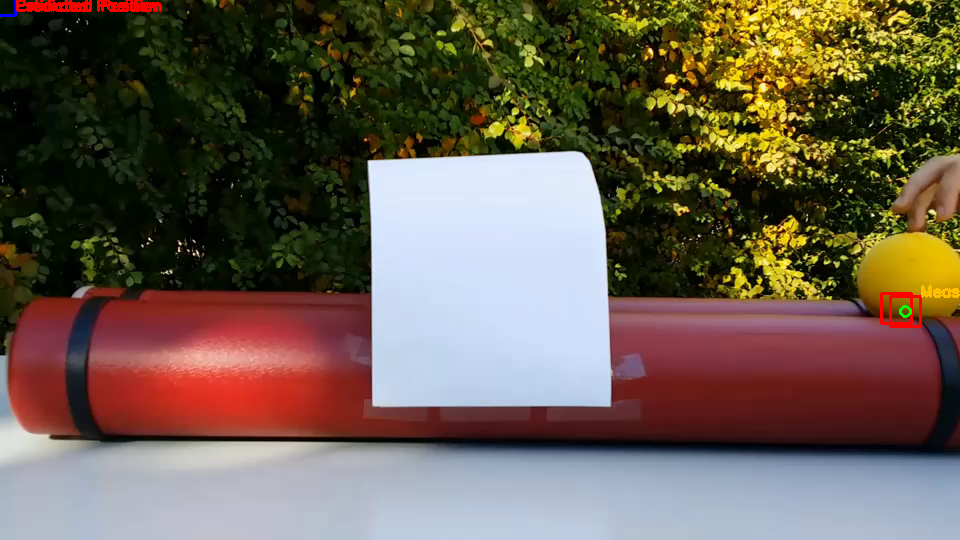

[[905 311]]


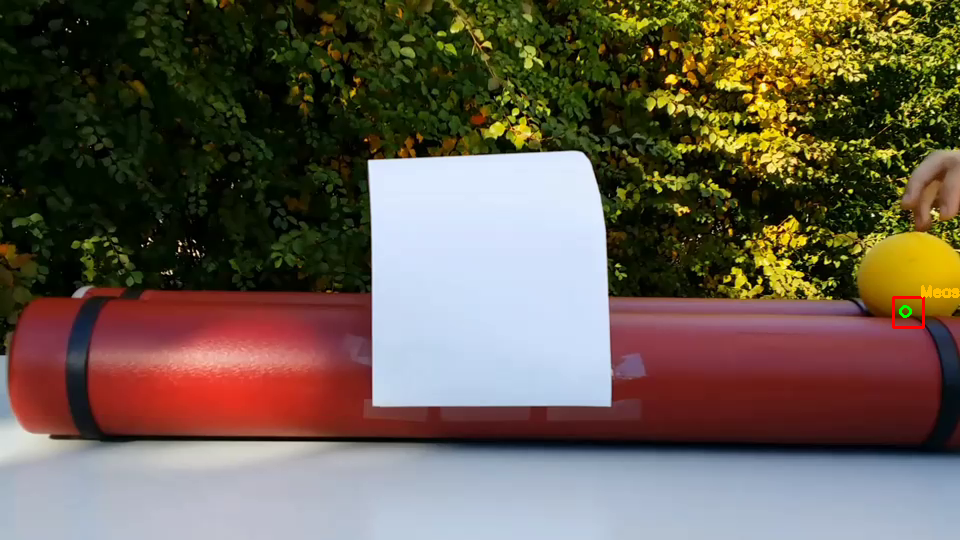

[[905 311]]


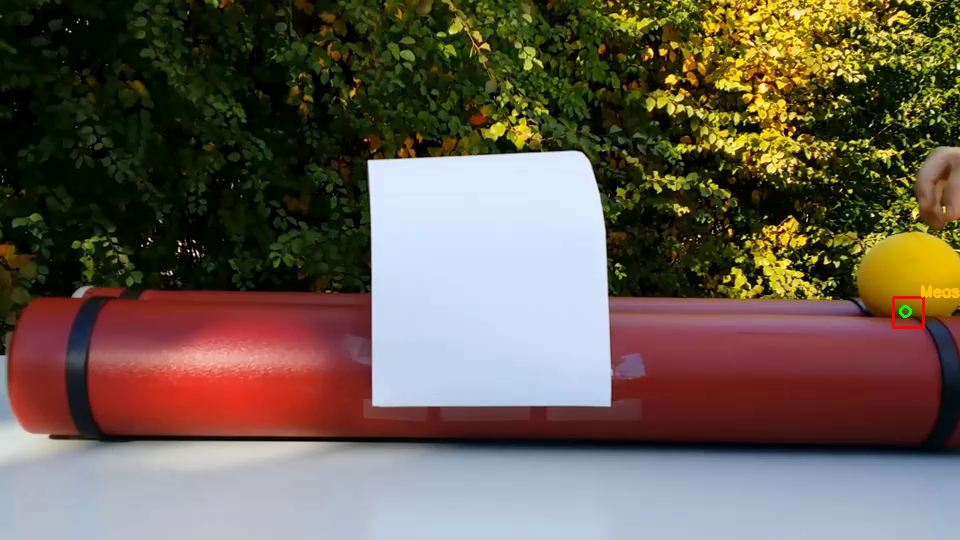

[[904 311]]


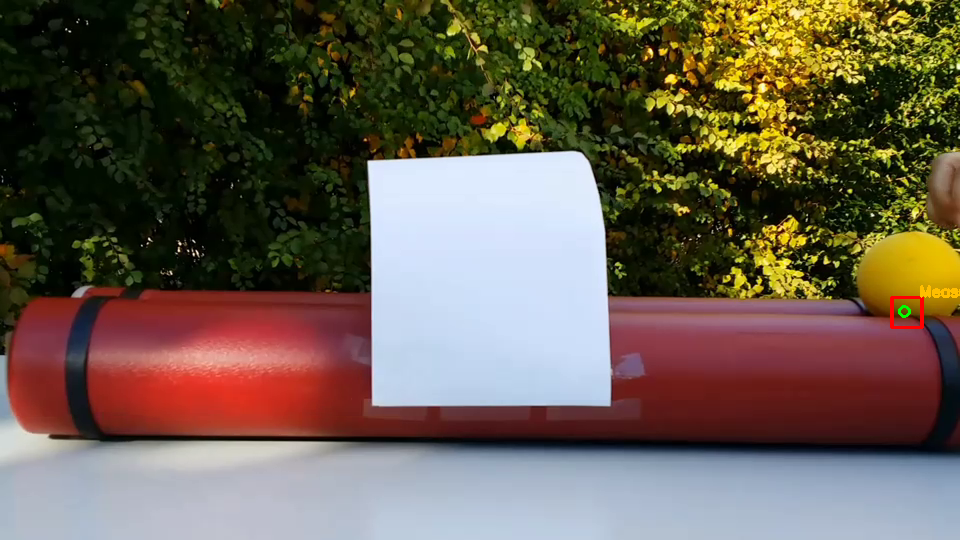

[[904 311]]


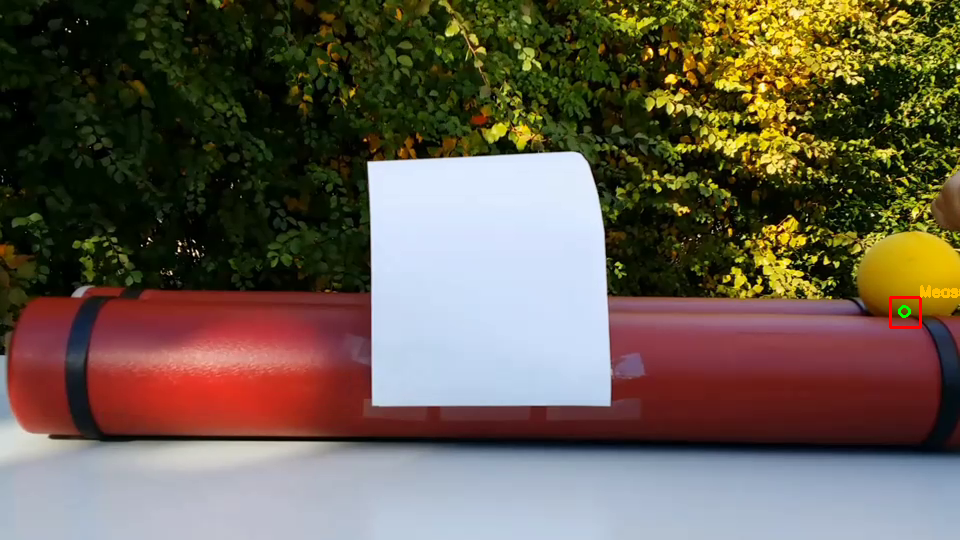

[[905 309]]


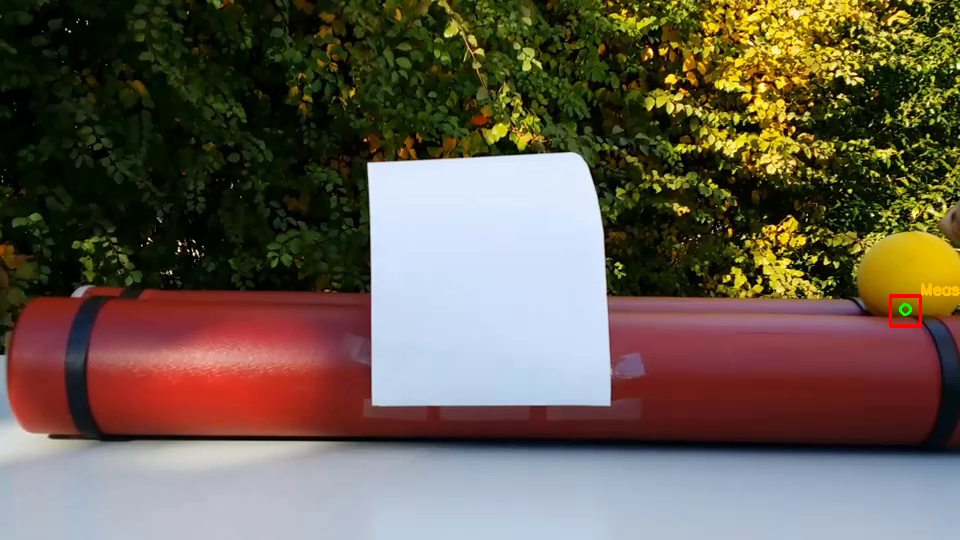

[[905 310]]


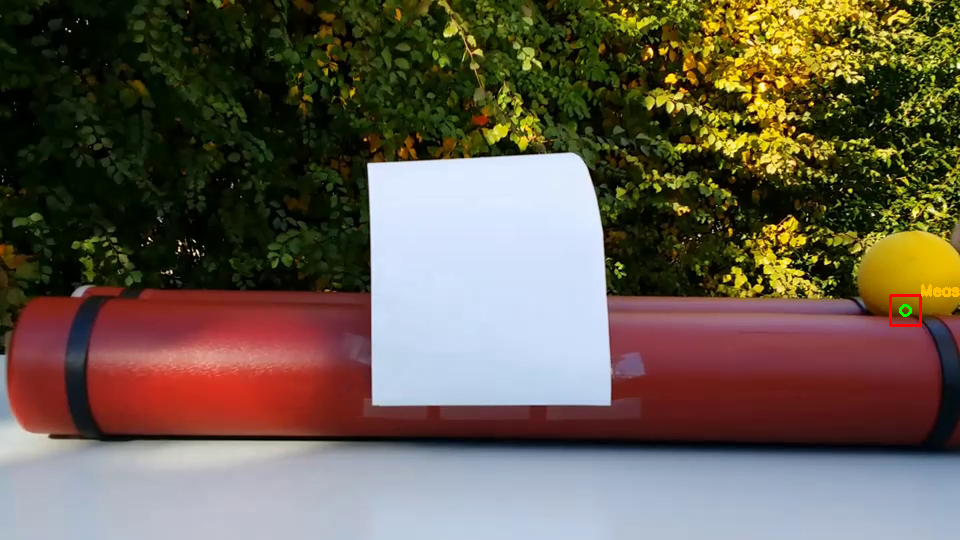

[[905 310]]


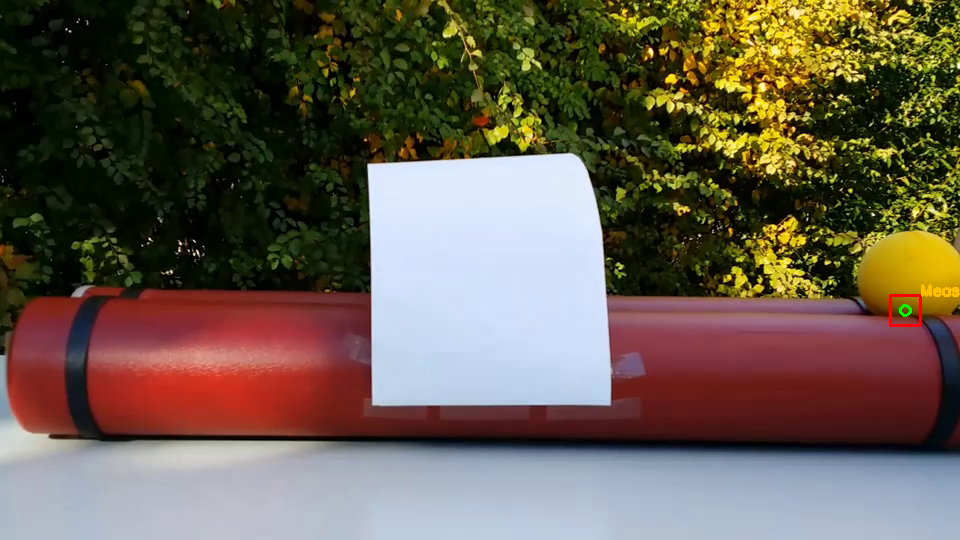

[[905 309]]


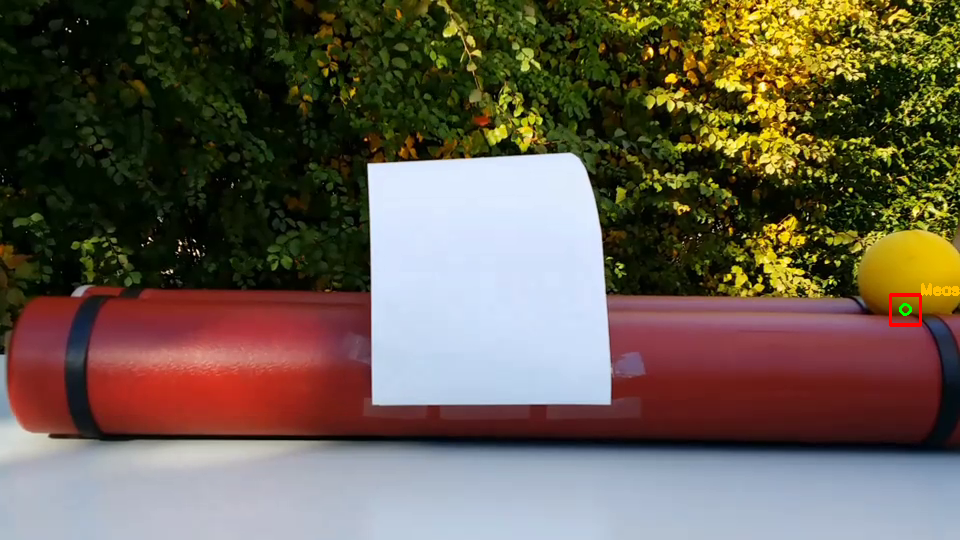

[[893 306]]


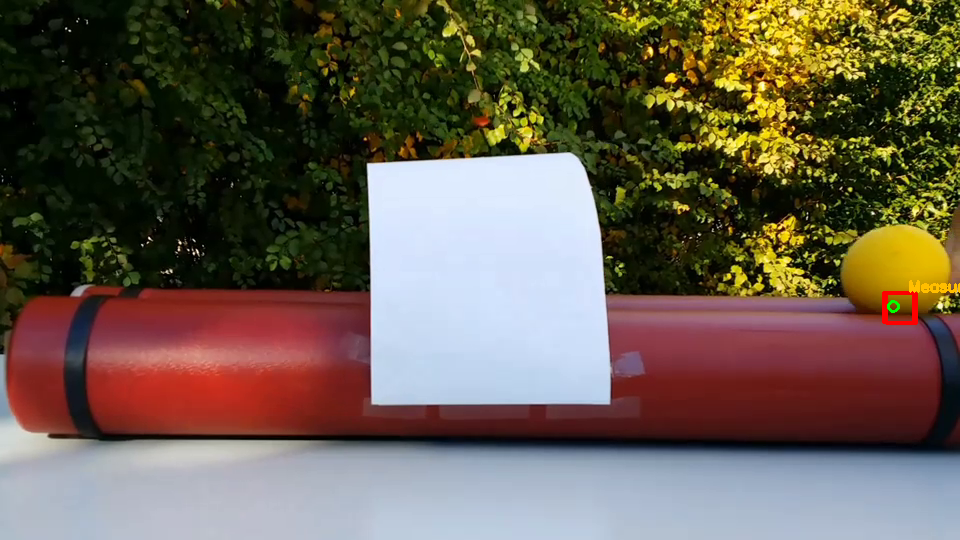

[[864 305]]


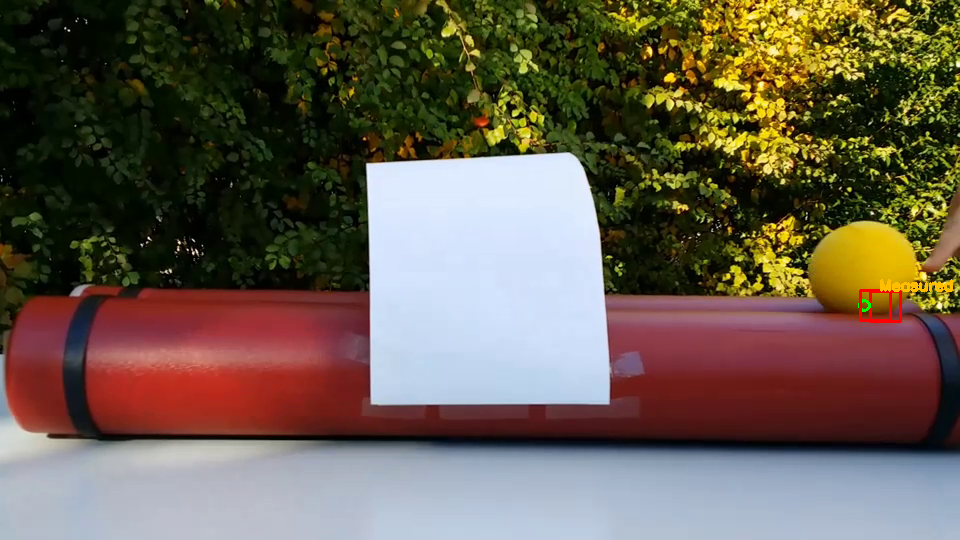

[[830 307]]


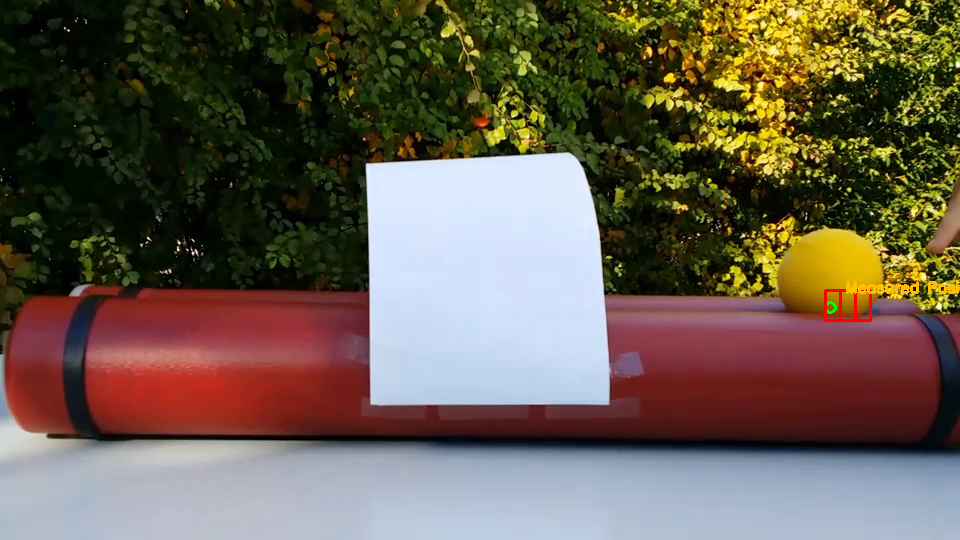

[[808 303]]


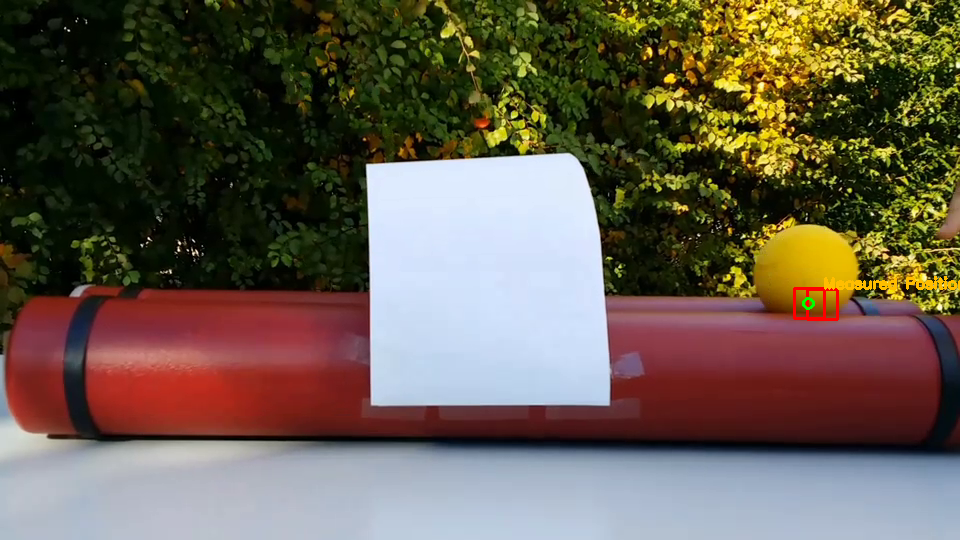

[[782 302]]


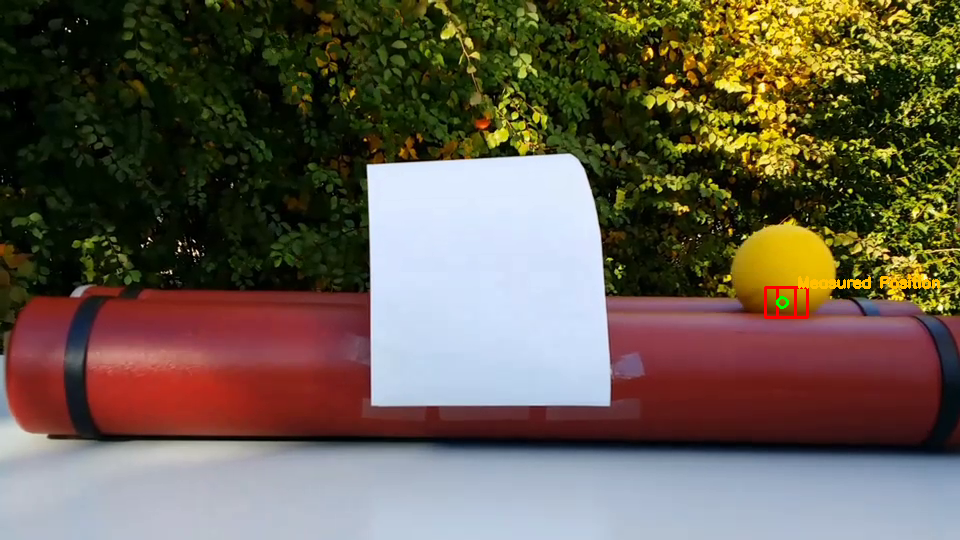

[[760 303]]


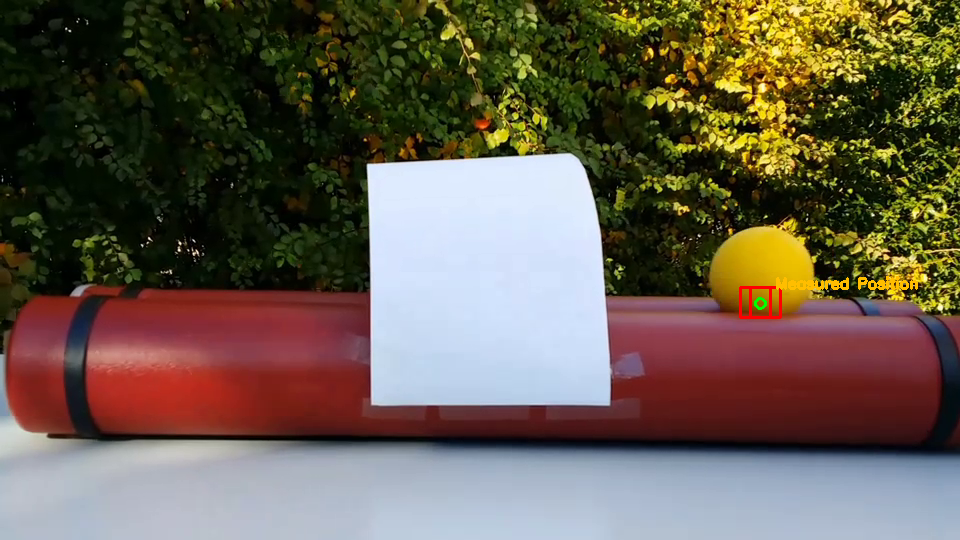

[[740 301]]


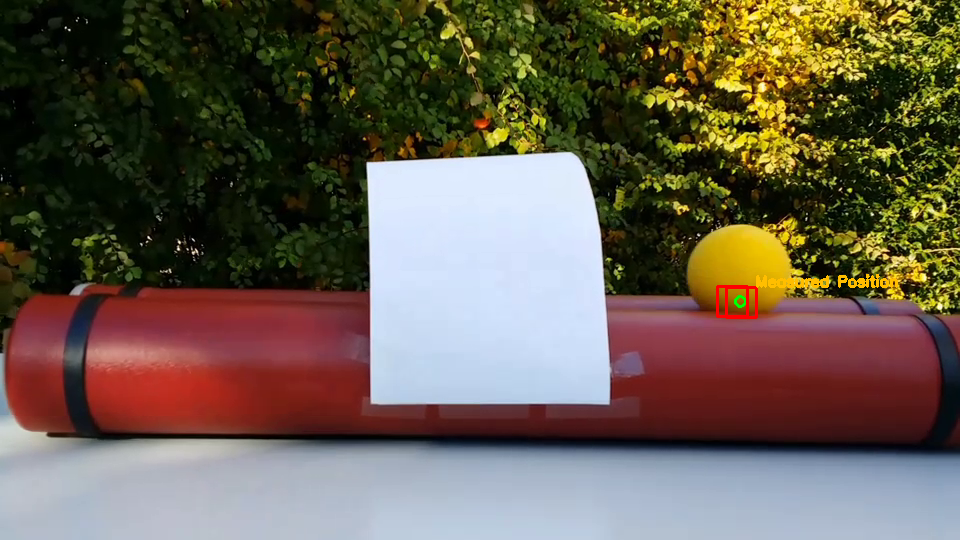

[[712 299]]


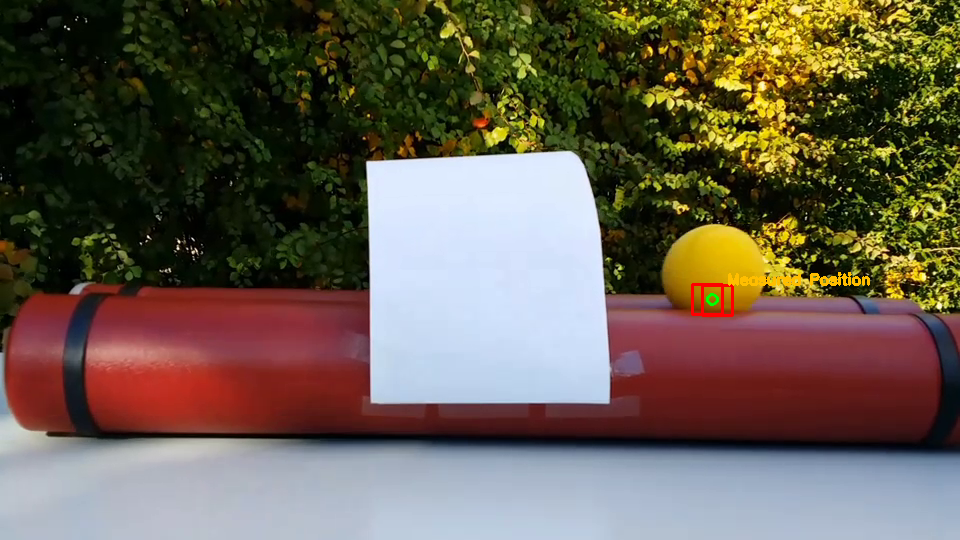

[[687 293]]


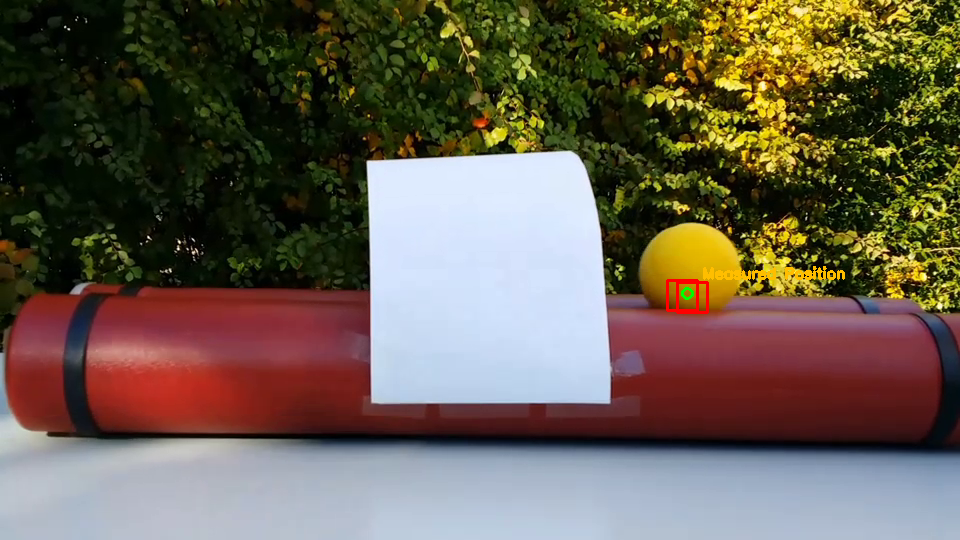

[[666 296]]


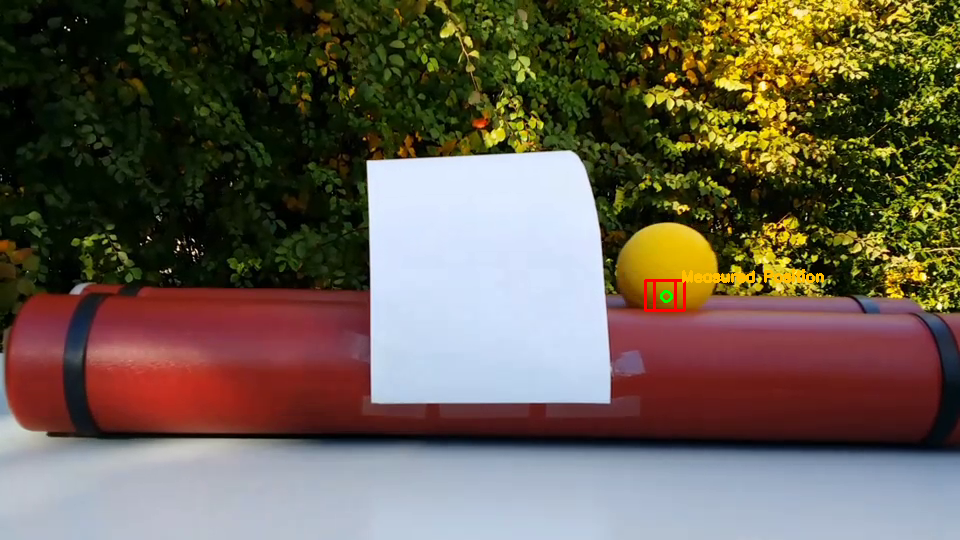

[[646 290]]


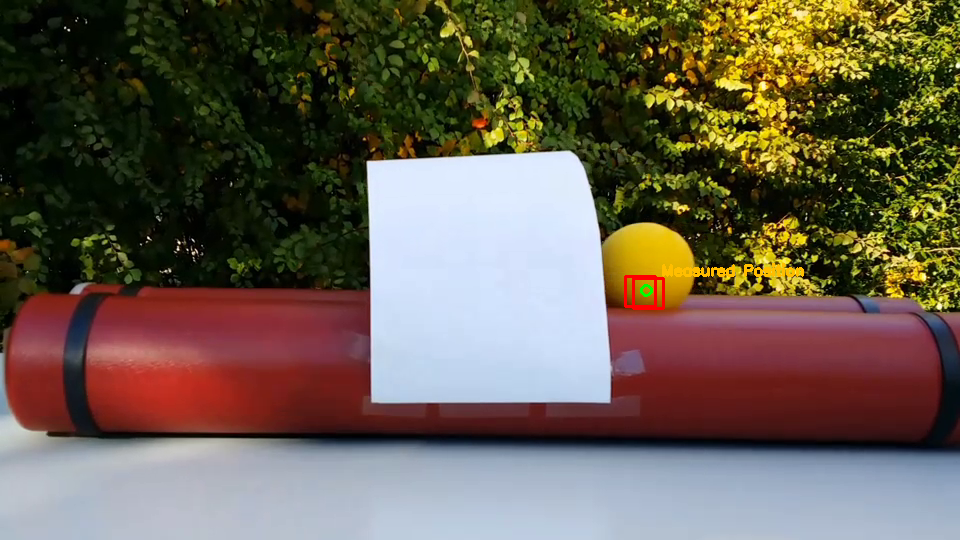

[[633 279]]


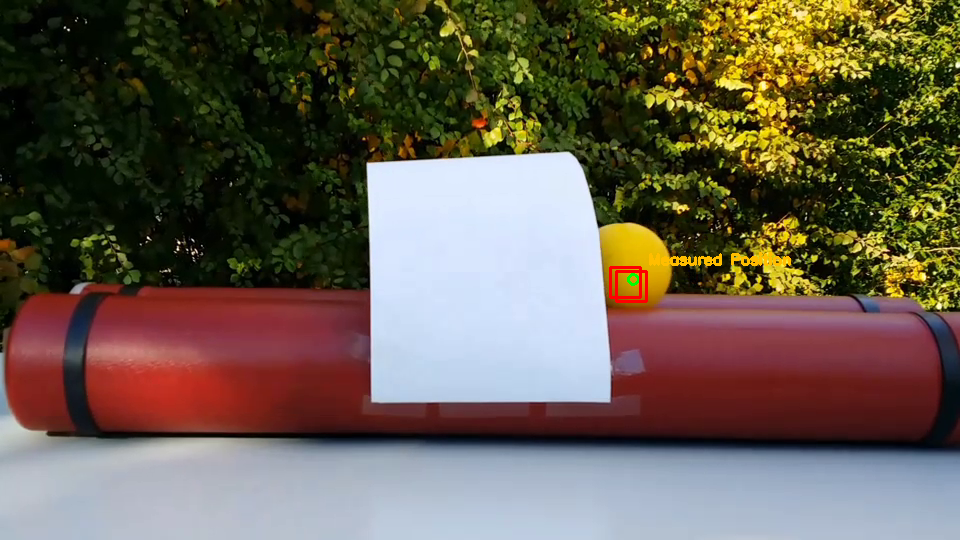

[[353 267]]


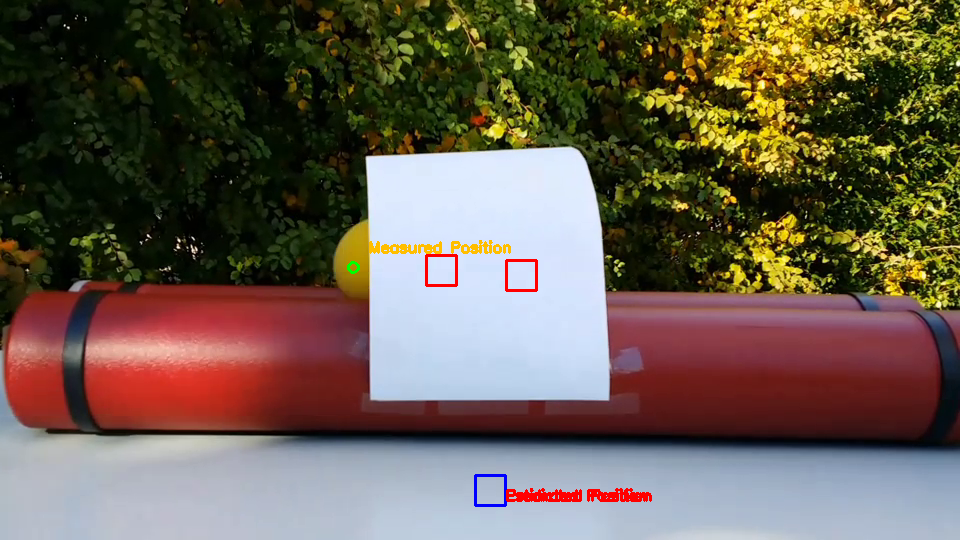

[[319 269]]


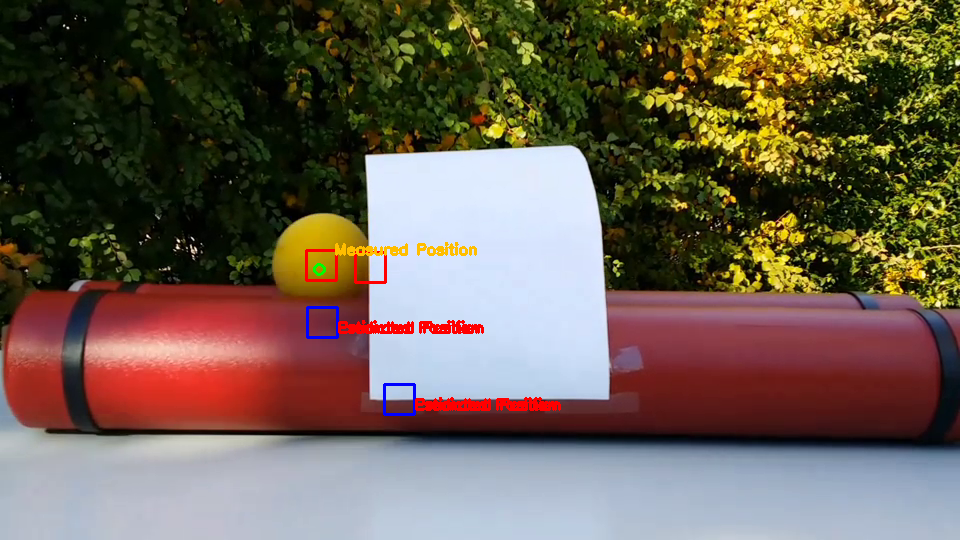

[[319 269]]


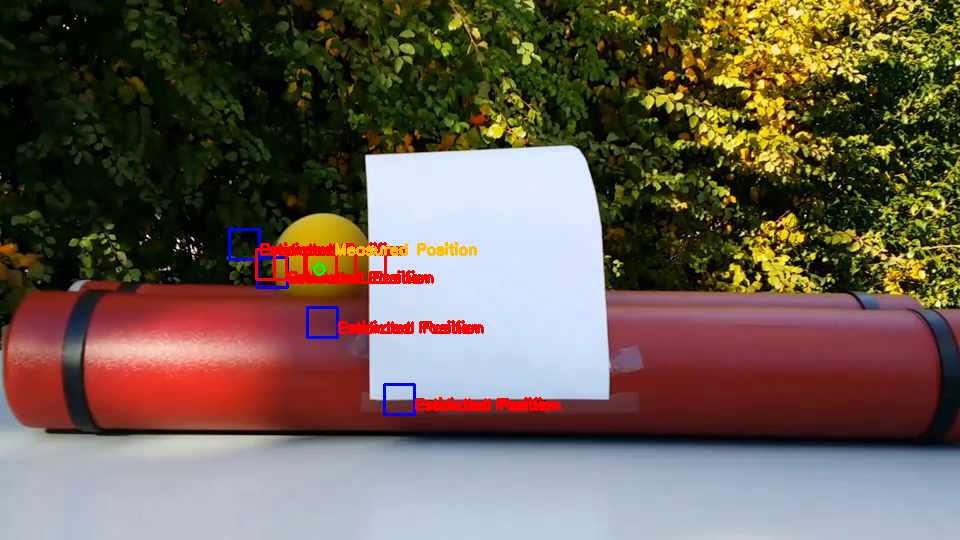

[[319 269]]


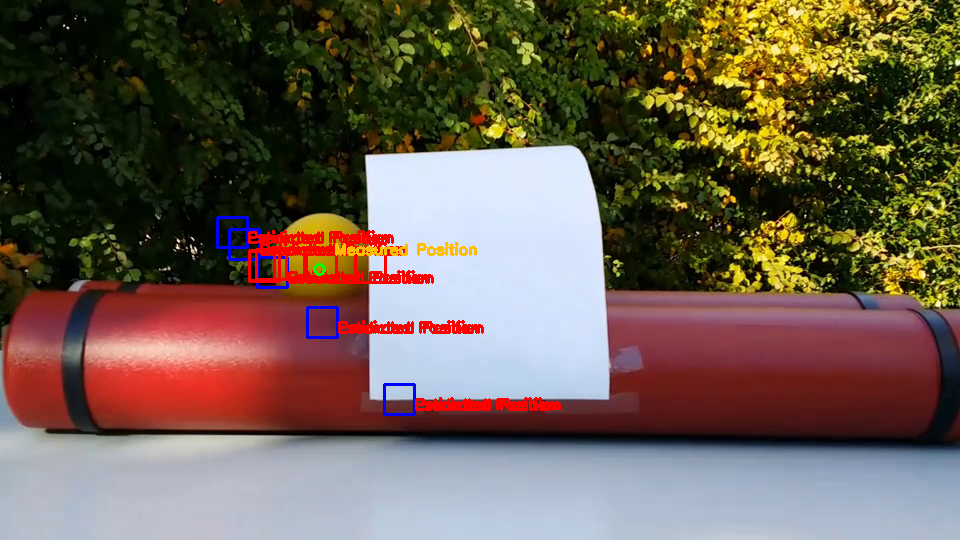

[[302 268]]


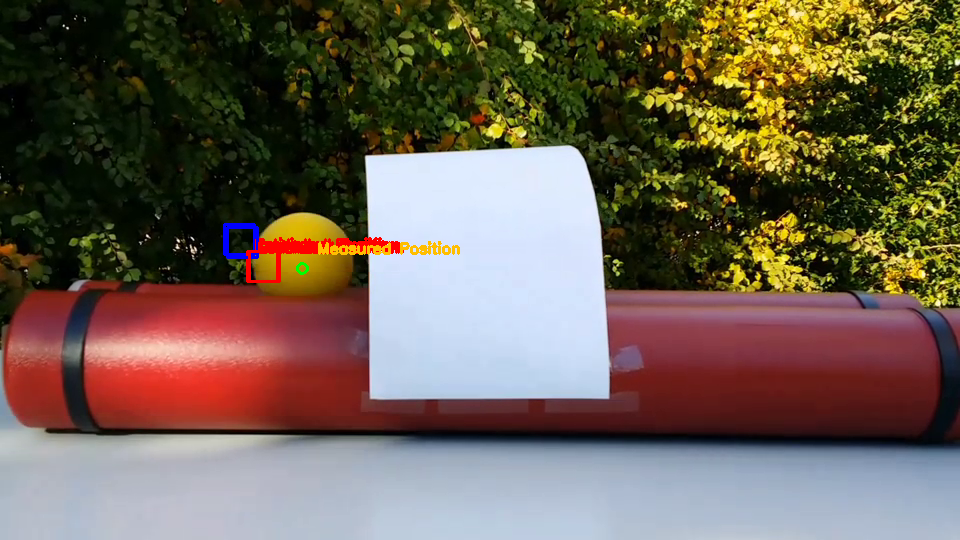

[[282 265]]


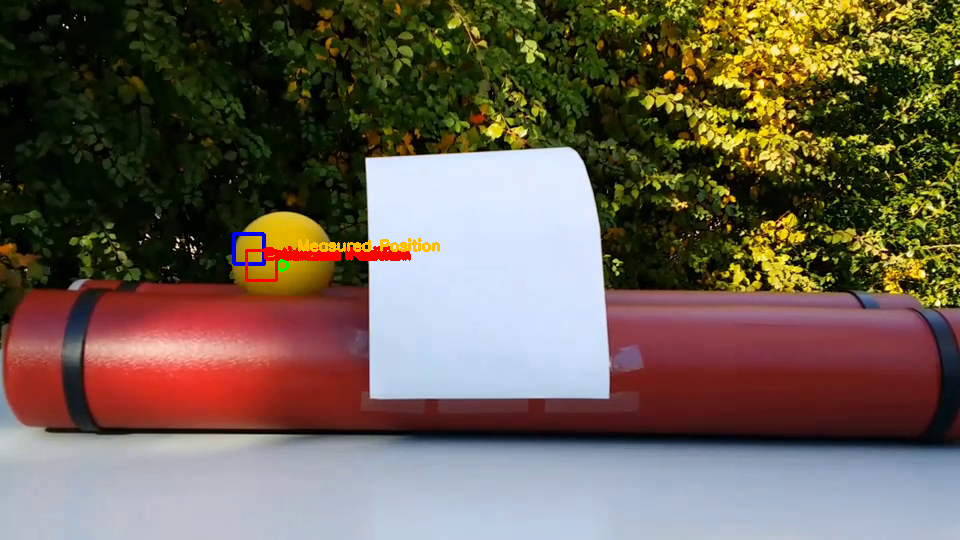

[[263 265]]


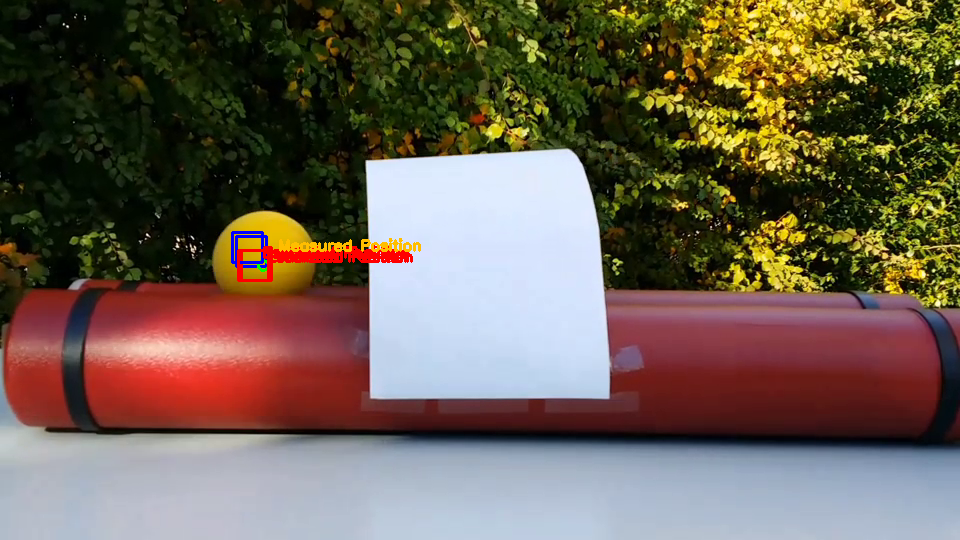

[[243 263]]


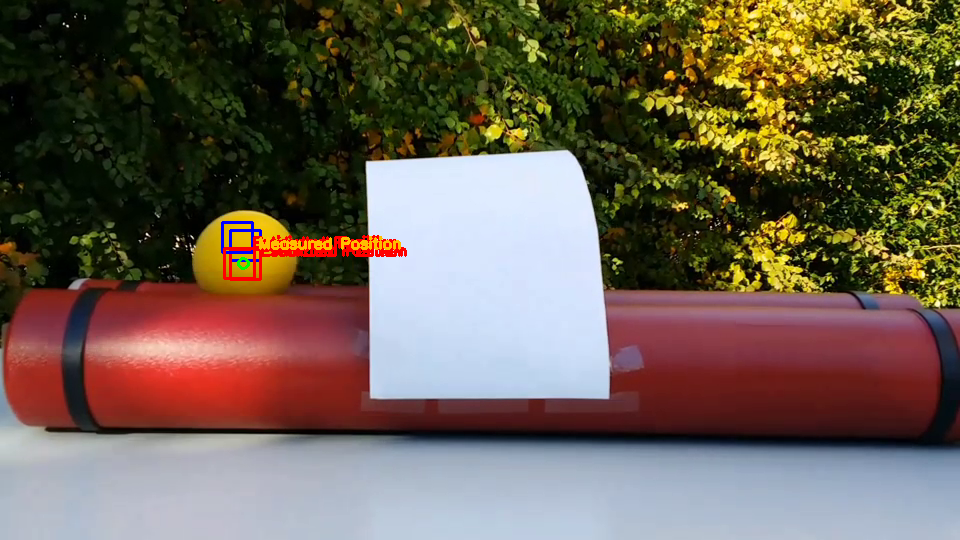

[[224 262]]


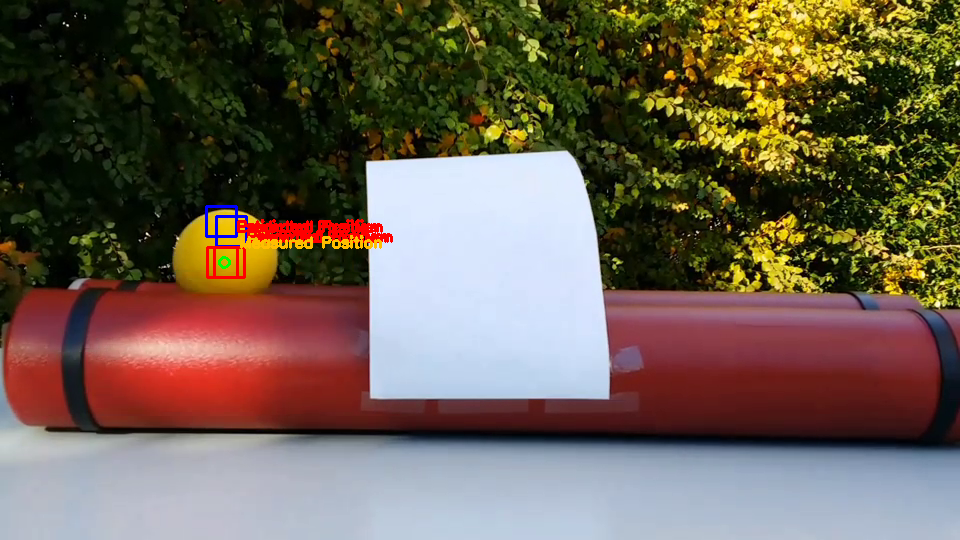

[[205 259]]


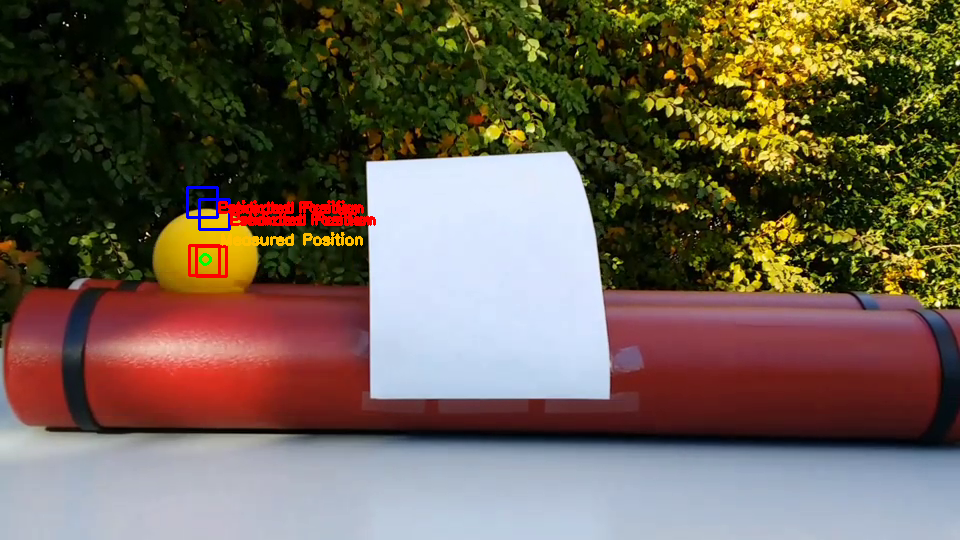

[[186 259]]


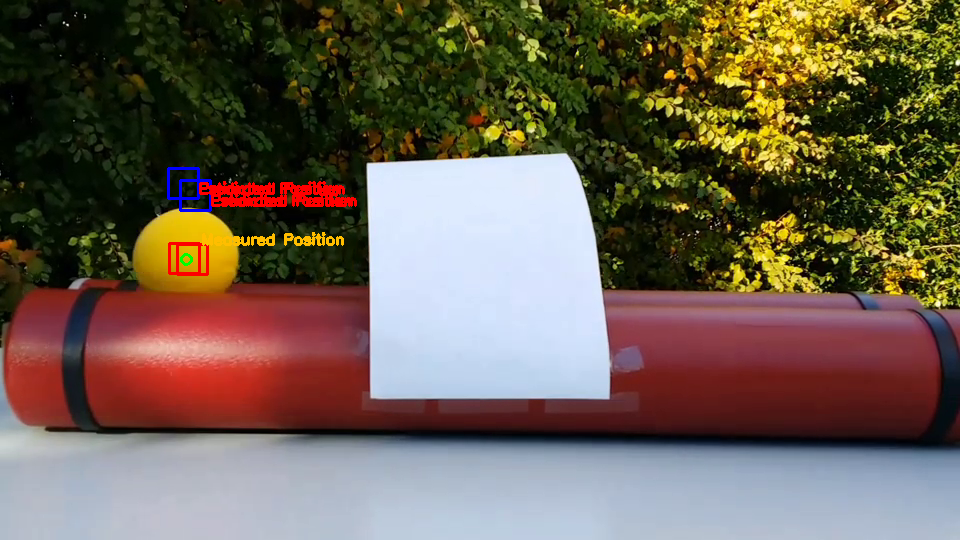

[[166 257]]


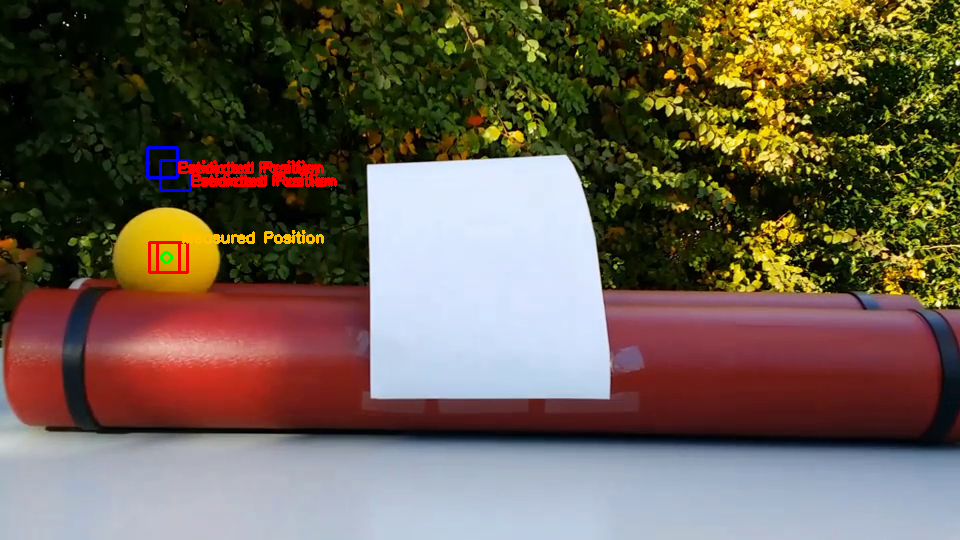

[[145 253]]


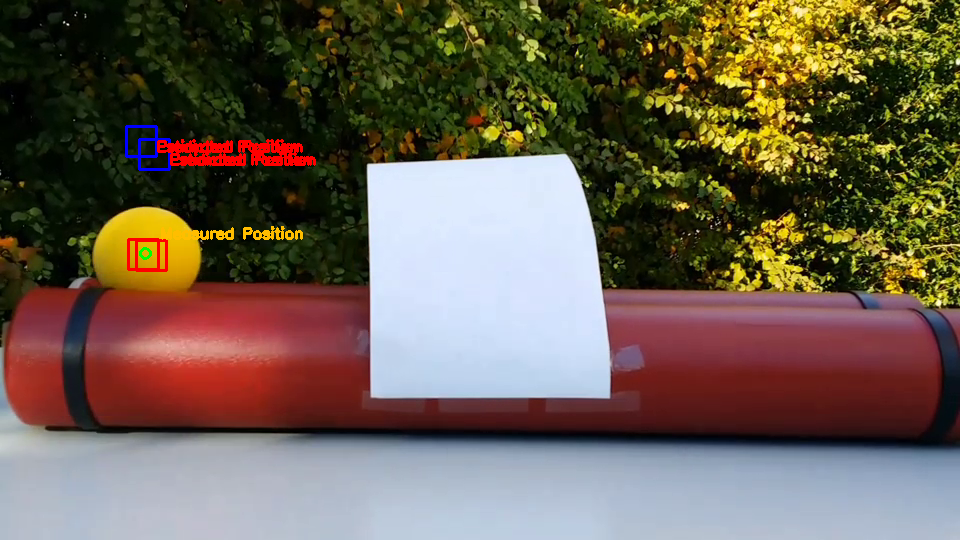

[[128 252]]


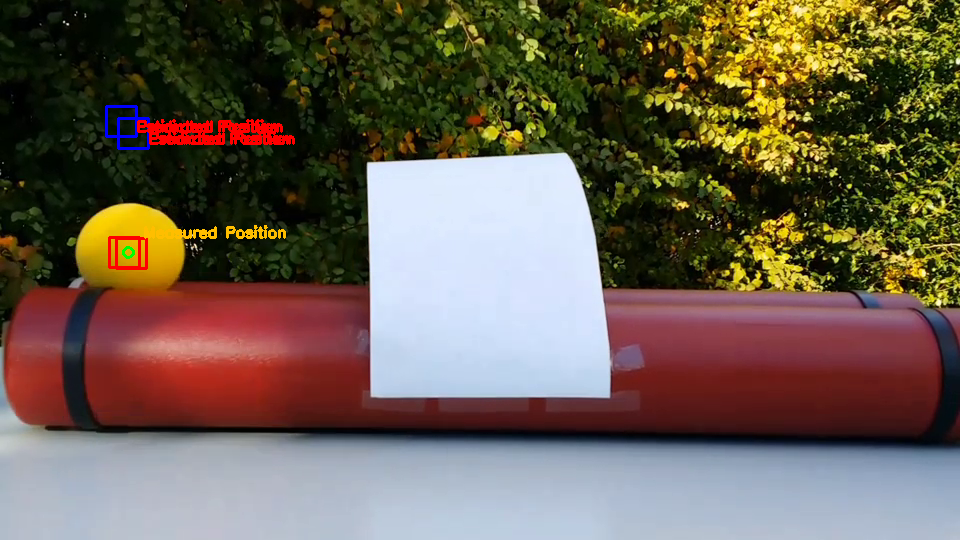

[[113 253]]


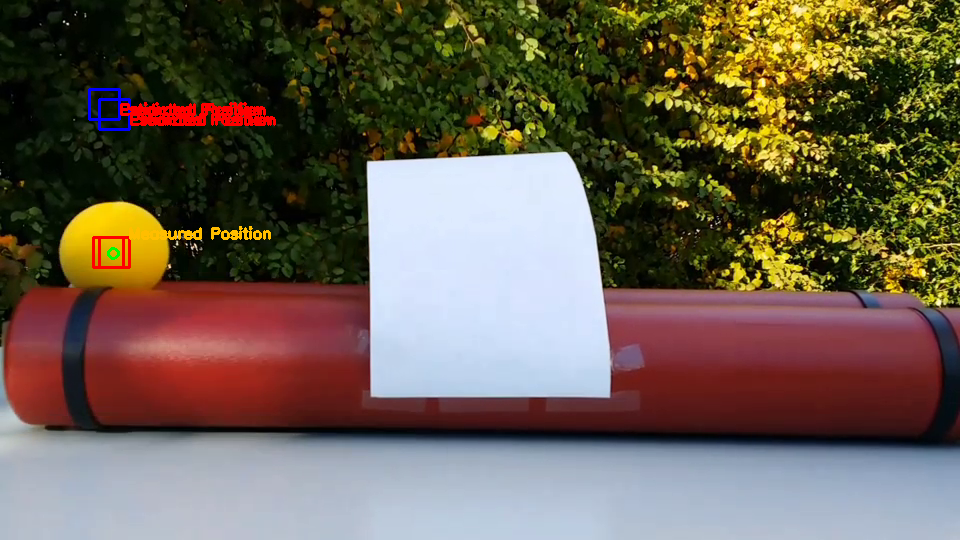

[[ 95 250]]


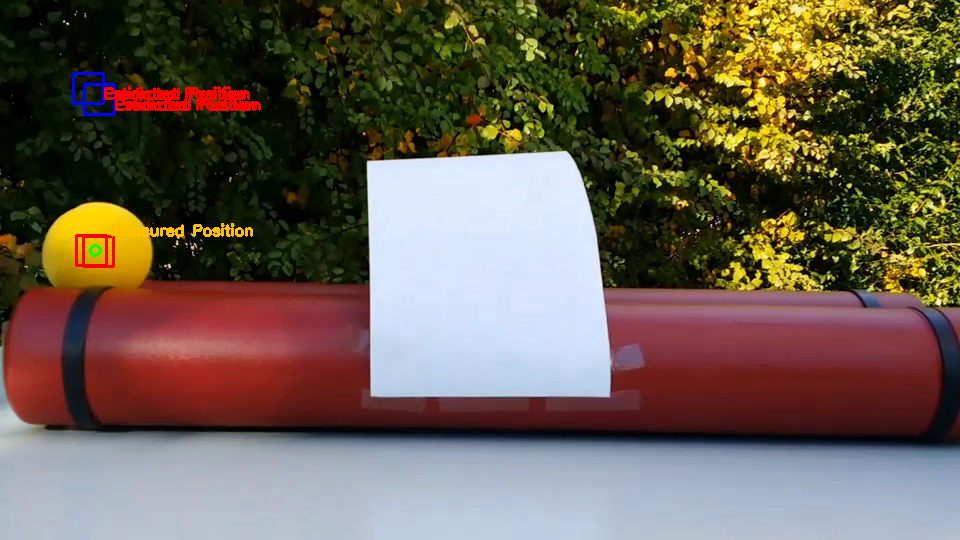

[[ 79 249]]


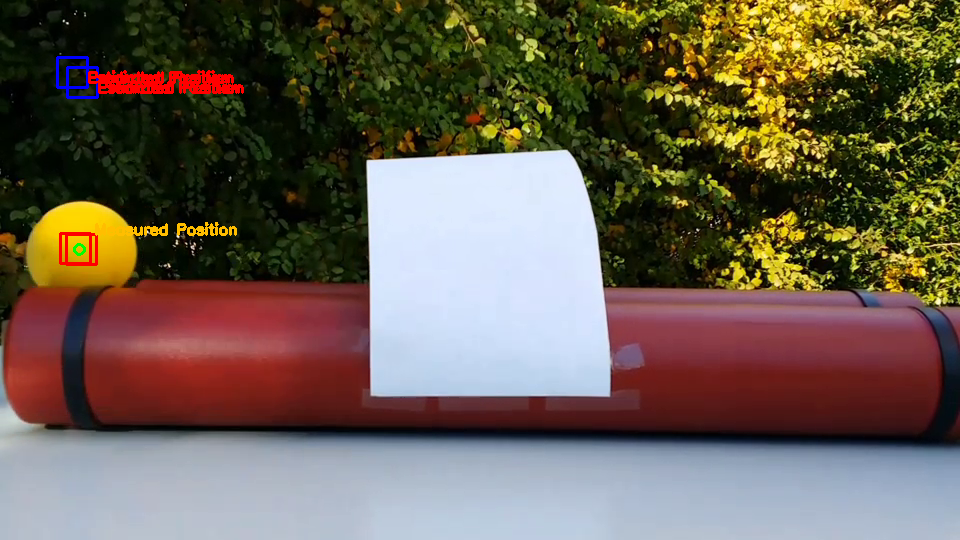

[[ 67 250]]


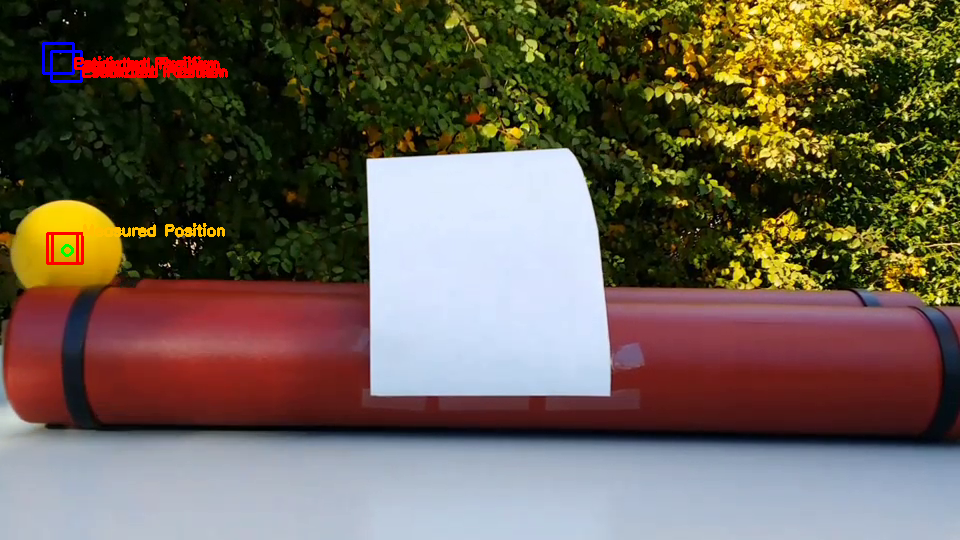

[[ 53 250]]


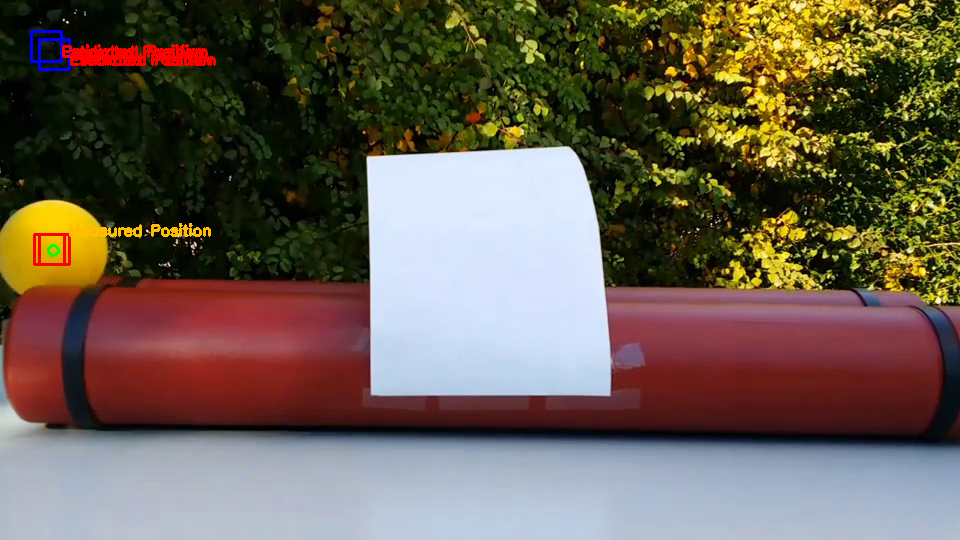

ValueError: ignored

In [9]:
from numpy.lib.function_base import vectorize
import numpy as np


KF= KalmanFilter(0.1, 1, 1, 1, 0.1, 0.1)
color=(255,0,0)
thickness= 2
highspeed=100
Controlspeed_var=30
current_directory=os.getcwd()
detector= ObjectDetection()
detector.setModelTypeAsYOLOv3()

detector.setModelPath('/content/drive/MyDrive/MOT_Assign/yolo.h5')
detector.loadModel()

print('Loading Model in a bit')


vidcap=cv2.VideoCapture('/content/drive/MyDrive/MOT_Assign/ball.mp4')
#success

while(True):
    ret,image= vidcap.read()
    #print("Inside Loop")
    #if ret is true
    detections=detector.detectObjectsFromImage(input_image=image, input_type="array",output_image_path=os.path.join(current_directory,"output.jpg"))

    rects=[]
    centers=[]
    
    for eachObject in detections:
        #print("Inside the loop")
        inputCentroids=np.zeros((len(detections),2),dtype='int')
        rects.append(eachObject["box_points"])
        
        for (i,(x1,y1,x2,y2)) in enumerate(rects):
          cx= int((x1+x2)/2)
          cy= int((y1+y2)/2)
          inputCentroids[i]=(cx,cy)
          new_centroid= np.array([inputCentroids[i]])
          print(new_centroid)


          for j in inputCentroids[i]:

            cv2.circle(image,(cx,cy),5,(0,255,0),thickness)
            predicted= np.array(KF.predict())
            x_p=int(predicted[0][0])
            y_p=int(predicted[0][0])

            cv2.rectangle(image,(x_p-15,y_p-15),(x_p+15,y_p+15),color,thickness)

            updated = np.array(KF.update(inputCentroids[i]))

            x_u=int(updated[0][0])
            y_u=int(updated[0][1])

            cv2.rectangle(image, (x_u-15,y_u-15),(x_u+15,y_u+15),(0,0,255),thickness)

            cv2.putText(image, "Estimated Position",(x_p+15,y_p+10),0,0.5,(0,0,255),2)
            cv2.putText(image, "Predicted Position",(x_p+15,y_p+10),0,0.5,(0,0,255),2)
            cv2.putText(image, "Measured Position",(cx+15,cy-15),0,0.5,(0,190,255),2)

          cv2_imshow(image)
        
        
        if cv2.waitKey(2) & 0xFF == ord('q'):
            vidcap.release()
            cv2.destroyAllWindows()
            break

        cv2.waitKey(highspeed-Controlspeed_var+1)

        
out = cv2.VideoWriter('Final.mp4',cv2.VideoWriter_fourcc(*'DIVX'),15,size)
for i in range(len(img_array)):
    out.write(img_array[i])
out.release()
